## Etape 1 - Importation des librairies et chargement des fichiers


<h3 style="margin: auto; padding: 20px; color:#fff; ">Etape 1.1 - Importation des librairies</h3>
</div>

In [79]:
#import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import warnings
from scipy.stats import chi2_contingency
from scipy.stats import pearsonr
from scipy.stats import spearmanr
from scipy.stats import ttest_ind
from scipy.stats import kruskal
from scipy.stats import shapiro
from scipy.stats import levene, f_oneway
import statsmodels.api as sm
import statsmodels.formula.api as smf
from scipy.stats import normaltest



<h3 style="margin: auto; padding: 20px; color:#fff; ">Etape 1.2 - Importation des Fichiers</h3>
</div>

In [80]:
# Load dataset with semicolon as delimiter
customers = pd.read_csv('customers.csv', sep=';')
products = pd.read_csv('products.csv', sep=';')
transactions = pd.read_csv('transactions.csv', sep=';')




C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\73701412.py:4: DtypeWarning:

Columns (0,1,2,3) have mixed types. Specify dtype option on import or set low_memory=False.



## Etape 2 - Controlées les données

In [81]:
# Data exploration and cleaning
# data Customers
# Display the first three rows of the customers DataFrame
customers.head(3)

,client_id,sex,birth
0,c_4410,f,1967
1,c_7839,f,1975
2,c_1699,f,1984


In [82]:
# customers format

customers.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8621 entries, 0 to 8620
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   client_id  8621 non-null   object
 1   sex        8621 non-null   object
 2   birth      8621 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 202.2+ KB


In [83]:
# check for missing values in the customers DataFrame

customers.isnull().sum()

client_id    0
sex          0
birth        0
dtype: int64

In [84]:
# Display the number of unique values in each column of the customers DataFrame

customers.nunique()

client_id    8621
sex             2
birth          76
dtype: int64

In [85]:
# data Products
# Display the first three rows of the products DataFrame

products.head(3)


,id_prod,price,categ
0,0_1421,19.99,0
1,0_1368,5.13,0
2,0_731,17.99,0


In [86]:
# products format

products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3286 entries, 0 to 3285
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   id_prod  3286 non-null   object 
 1   price    3286 non-null   float64
 2   categ    3286 non-null   int64  
dtypes: float64(1), int64(1), object(1)
memory usage: 77.1+ KB


In [87]:
# check for missing values in the products DataFrame

products.isnull().sum()

id_prod    0
price      0
categ      0
dtype: int64

In [88]:
# Display the number of unique values in each column of the products DataFrame

products.nunique()

id_prod    3286
price      1454
categ         3
dtype: int64

In [89]:
# min and max of price
products['price'].min(), products['price'].max()

(0.62, 300.0)

In [90]:
# data Transactions
# Display the first three rows of the transactions DataFrame

transactions.head(3)

,id_prod,date,session_id,client_id
0,0_1259,2021-03-01 00:01:07.843138,s_1,c_329
1,0_1390,2021-03-01 00:02:26.047414,s_2,c_664
2,0_1352,2021-03-01 00:02:38.311413,s_3,c_580


In [91]:
# last three rows of the transactions DataFrame

transactions.tail(3)

,id_prod,date,session_id,client_id
1048572,NaN,NaN,NaN,NaN
1048573,NaN,NaN,NaN,NaN
1048574,NaN,NaN,NaN,NaN


In [92]:
# transactions format

transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 4 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   id_prod     687534 non-null  object
 1   date        687534 non-null  object
 2   session_id  687534 non-null  object
 3   client_id   687534 non-null  object
dtypes: object(4)
memory usage: 32.0+ MB


In [93]:
# check for missing values in the transactions DataFrame

transactions.isnull().sum()

id_prod       361041
date          361041
session_id    361041
client_id     361041
dtype: int64

In [94]:
#delete rows with missing values in the transactions DataFrame

transactions.dropna(inplace=True)

In [95]:
# Display the number of unique values in each column of the transactions DataFrame

transactions.nunique()

id_prod         3265
date          687419
session_id    345505
client_id       8600
dtype: int64

## Étape 3 - merge des fichers

In [96]:
# merge the customers, products, and transactions DataFrames
# merge the customers and transactions DataFrames   on the 'client_id' column  

merged_df = pd.merge(customers, transactions, on='client_id', how='outer')
merged_df.head(3)

,client_id,sex,birth,id_prod,date,session_id
0,c_1,m,1955,0_1470,2021-06-11 21:02:39.382765,s_47346
1,c_1,m,1955,0_513,2021-07-21 22:41:38.769525,s_65433
2,c_1,m,1955,0_1186,2021-07-25 12:17:34.446678,s_66947


In [97]:
# merge the products and transactions DataFrames on the 'product_id' column

merged_df = pd.merge(merged_df, products, on='id_prod', how='outer')
merged_df.head(3)

,client_id,sex,birth,id_prod,date,session_id,price,categ
0,c_1004,m,1973.0,0_0,2021-03-02 21:57:33.862118,s_908,3.75,0.0
1,c_1011,f,1999.0,0_0,2022-02-18 16:40:10.068303,s_167174,3.75,0.0
2,c_1011,f,1999.0,0_0,2022-03-18 16:40:10.068303,s_180968,3.75,0.0


In [98]:
# change date format to datetime
# Convert the 'date' column to datetime format

merged_df['date'] = pd.to_datetime(merged_df['date'])

In [99]:
# ajoute de la colonne 'age' dans le DataFrame merged_df
# Create a new column 'age' in the merged_df DataFrame
merged_df['age'] = merged_df['date'].dt.year - merged_df['birth']

merged_df.head(3)

,client_id,sex,birth,id_prod,date,session_id,price,categ,age
0,c_1004,m,1973.0,0_0,2021-03-02 21:57:33.862118,s_908,3.75,0.0,48.0
1,c_1011,f,1999.0,0_0,2022-02-18 16:40:10.068303,s_167174,3.75,0.0,23.0
2,c_1011,f,1999.0,0_0,2022-03-18 16:40:10.068303,s_180968,3.75,0.0,23.0


In [100]:
print("Missing values in dataset:")
print(merged_df[['age', 'price']].isnull().sum())
merged_df = merged_df.dropna(subset=['age', 'price'])


Missing values in dataset:
age      42
price    21
dtype: int64


## Etape 4 - Split des clients pro et particulier

In [101]:
# sum per client_id of prices of products bought

total_spent_per_client = merged_df.groupby('client_id')['price'].sum().reset_index()
total_spent_per_client.head(3)

,client_id,price
0,c_1,629.02
1,c_10,1353.60
2,c_100,254.85


In [102]:
# top 10 clients by total spent

top_10_clients = total_spent_per_client.nlargest(10, 'price')
top_10_clients

,client_id,price
677,c_1609,326039.89
4388,c_4958,290227.03
6337,c_6714,153918.60
2724,c_3454,114110.57
634,c_1570,5285.82
2513,c_3263,5276.87
1268,c_2140,5260.18
2108,c_2899,5214.05
7006,c_7319,5155.77
7715,c_7959,5135.75


In [103]:
# make a different table for the top 4 clients

top_4_clients = top_10_clients.iloc[:4]
top_4_clients

,client_id,price
677,c_1609,326039.89
4388,c_4958,290227.03
6337,c_6714,153918.60
2724,c_3454,114110.57


In [104]:
# exclude the top 4 clients from the merged DataFrame

Particulier_df = merged_df[~merged_df['client_id'].isin(top_4_clients['client_id'])]
Particulier_df.head(3)

,client_id,sex,birth,id_prod,date,session_id,price,categ,age
0,c_1004,m,1973.0,0_0,2021-03-02 21:57:33.862118,s_908,3.75,0.0,48.0
1,c_1011,f,1999.0,0_0,2022-02-18 16:40:10.068303,s_167174,3.75,0.0,23.0
2,c_1011,f,1999.0,0_0,2022-03-18 16:40:10.068303,s_180968,3.75,0.0,23.0


In [105]:
#the top 4 clients from the merged DataFrame
pro_df = merged_df[merged_df['client_id'].isin(top_4_clients['client_id'])]
pro_df.head(3)

,client_id,sex,birth,id_prod,date,session_id,price,categ,age
104,c_1609,m,1980.0,0_0,2021-03-22 23:37:09.874830,s_10114,3.75,0.0,41.0
105,c_1609,m,1980.0,0_0,2021-04-08 15:29:10.605154,s_17758,3.75,0.0,41.0
106,c_1609,m,1980.0,0_0,2021-04-17 20:09:37.561114,s_21987,3.75,0.0,41.0


## Etape 5 - Analyse Particulier

In [106]:
# top 10 clients by total spent (excluding the top 4)

top_10_clients_excluding_top_4 = Particulier_df.groupby('client_id')['price'].sum().reset_index().nlargest(10, 'price')
top_10_clients_excluding_top_4

,client_id,price
634,c_1570,5285.82
2512,c_3263,5276.87
1267,c_2140,5260.18
2107,c_2899,5214.05
7002,c_7319,5155.77
7711,c_7959,5135.75
470,c_1422,5131.36
7116,c_7421,5097.18
7787,c_8026,5082.58
1672,c_2505,5059.35


In [107]:
# evolution of money spent over time by the rest of the clients (excluding the top 4)

evolution_df = Particulier_df.groupby(['date'])['price'].sum().reset_index()
fig = px.line(evolution_df, x='date', y='price', title='Evolution of money spent by filtered clients over time')
fig.show()

In [108]:


# Convert 'date' column to datetime
Particulier_df['date'] = pd.to_datetime(Particulier_df['date'])

# Extract year and month for grouping
Particulier_df['year_month'] = Particulier_df['date'].dt.to_period('M')

# Group by year and month and sum the values
evolution_df = Particulier_df.groupby('year_month')['price'].sum().reset_index()
evolution_df['year_month'] = evolution_df['year_month'].astype(str)

# Create the line plot
fig = px.line(evolution_df, x='year_month', y='price', title='Evolution of money spent by month')
fig.show()


C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\1558443723.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\1558443723.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [109]:
# evolution of money spent over time by the rest of the clients by month 
Particulier_df['date'] = pd.to_datetime(Particulier_df['date'])
Particulier_df['month'] = Particulier_df['date'].dt.month
Particulier_df['year'] = Particulier_df['date'].dt.year

evolution_df_month = Particulier_df.groupby(['year','month'])['price'].sum().reset_index()

fig = px.line(evolution_df_month, x='month', y='price', color='year', title='CA par mois par année')

fig.show()


C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\3944044621.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\3944044621.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\3944044621.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

In [110]:
# chiffre d'affaires par annee et par mois et par semaine
Particulier_df['date'] = pd.to_datetime(Particulier_df['date'])
Particulier_df['year'] = Particulier_df['date'].dt.year
Particulier_df['month'] = Particulier_df['date'].dt.month
Particulier_df['week'] = Particulier_df['date'].dt.isocalendar().week
Particulier_df['day'] = Particulier_df['date'].dt.day

# sum of price by year
chiffre_affaires_year = Particulier_df.groupby(['year'])['price'].sum().reset_index()   
chiffre_affaires_year.head(3)



C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\316914637.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\316914637.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\316914637.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs

,year,price
0,2021,4584976.14
1,2022,5655420.93
2,2023,902969.94


In [111]:
# sum of price by month
chiffre_affaires_month = Particulier_df.groupby(['year', 'month'])['price'].sum().reset_index()
chiffre_affaires_month.head(50)

,year,month,price
0,2021,3,445918.71
1,2021,4,439337.85
2,2021,5,454887.46
3,2021,6,447102.17
4,2021,7,447593.15
5,2021,8,446002.30
6,2021,9,470921.80
7,2021,10,467397.22
8,2021,11,478092.08
9,2021,12,487723.40


   categ       price
0    0.0  4119200.69
1    1.0  4520101.86
2    2.0  2504064.46


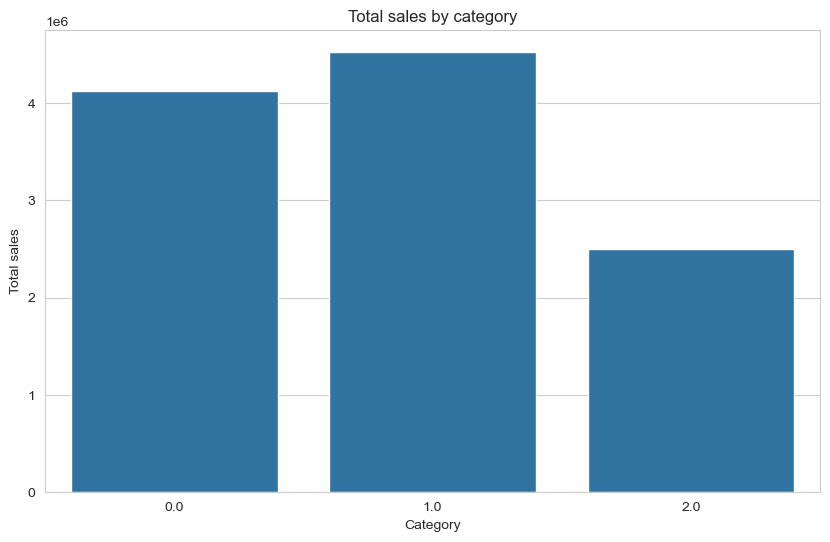

In [112]:
#chiffre d'affaires par categorie
# Group by category and sum the values
category_sales = Particulier_df.groupby('categ')['price'].sum().reset_index()
print(category_sales)

# Create the bar chart
plt.figure(figsize=(10,6))
sns.barplot(x='categ', y='price', data=category_sales)
plt.title('Total sales by category')
plt.xlabel('Category')
plt.ylabel('Total sales')
plt.show()


   year_month  client_id
0     2021-03       5672
1     2021-04       5670
2     2021-05       5640
3     2021-06       5655
4     2021-07       5668
5     2021-08       5638
6     2021-09       5689
7     2021-10       6186
8     2021-11       5871
9     2021-12       5863
10    2022-01       5805
11    2022-02       5725
12    2022-03       5831
13    2022-04       5691
14    2022-05       5839
15    2022-06       5713
16    2022-07       5774
17    2022-08       5801
18    2022-09       5734
19    2022-10       5751
20    2022-11       5745
21    2022-12       5761
22    2023-01       5824
23    2023-02       5583


C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\266246162.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



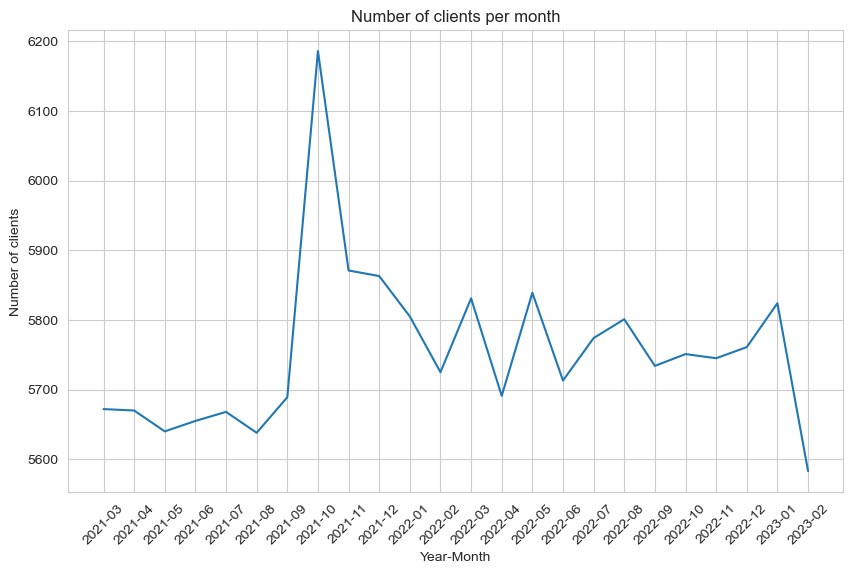

In [113]:
# nombre de clients par mois 
# Extract year and month for grouping
Particulier_df['year_month'] = Particulier_df['date'].dt.to_period('M')

# Group by year and month and count the values
clients_per_month = Particulier_df.groupby('year_month')['client_id'].nunique().reset_index()
clients_per_month['year_month'] = clients_per_month['year_month'].astype(str)
print(clients_per_month)

# Create the line plot
plt.figure(figsize=(10,6))
sns.lineplot(x='year_month', y='client_id', data=clients_per_month)
plt.title('Number of clients per month')
plt.xlabel('Year-Month')
plt.ylabel('Number of clients')
plt.xticks(rotation=45)
plt.show()

   year_month  session_id
0     2021-03       26647
1     2021-04       26470
2     2021-05       26272
3     2021-06       25038
4     2021-07       23075
5     2021-08       23955
6     2021-09       30975
7     2021-10       28313
8     2021-11       26319
9     2021-12       30208
10    2022-01       27416
11    2022-02       27569
12    2022-03       27703
13    2022-04       25659
14    2022-05       27946
15    2022-06       26479
16    2022-07       26715
17    2022-08       26622
18    2022-09       26387
19    2022-10       27014
20    2022-11       26641
21    2022-12       26519
22    2023-01       27019
23    2023-02       23773


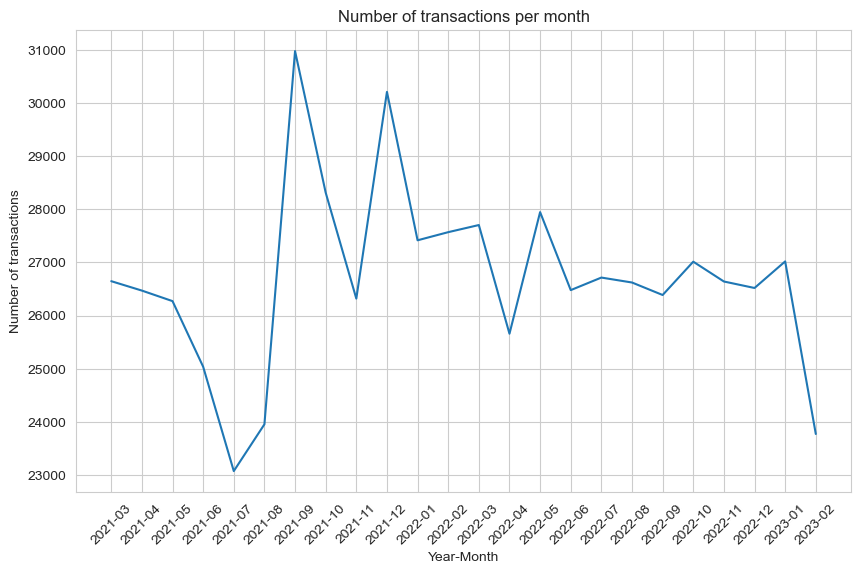

In [114]:
#nombre de transactions par mois
# Group by year and month and count the values
transactions_per_month = Particulier_df.groupby('year_month')['session_id'].count().reset_index()
transactions_per_month['year_month'] = transactions_per_month['year_month'].astype(str)

transactions_per_month = transactions_per_month[['year_month', 'session_id']]
print(transactions_per_month) 
# graphique du nombre de transactions par mois
# Create the line plot
plt.figure(figsize=(10,6))
sns.lineplot(x='year_month', y='session_id', data=transactions_per_month)
plt.title('Number of transactions per month')
plt.xlabel('Year-Month')
plt.ylabel('Number of transactions')
plt.xticks(rotation=45) 
plt.show()

   year_month  id_prod
0     2021-03     2436
1     2021-04     2452
2     2021-05     2437
3     2021-06     2363
4     2021-07     2324
5     2021-08     2361
6     2021-09     2517
7     2021-10     2468
8     2021-11     2398
9     2021-12     2463
10    2022-01     2431
11    2022-02     2439
12    2022-03     2434
13    2022-04     2417
14    2022-05     2435
15    2022-06     2412
16    2022-07     2427
17    2022-08     2420
18    2022-09     2406
19    2022-10     2450
20    2022-11     2403
21    2022-12     2398
22    2023-01     2448
23    2023-02     2383


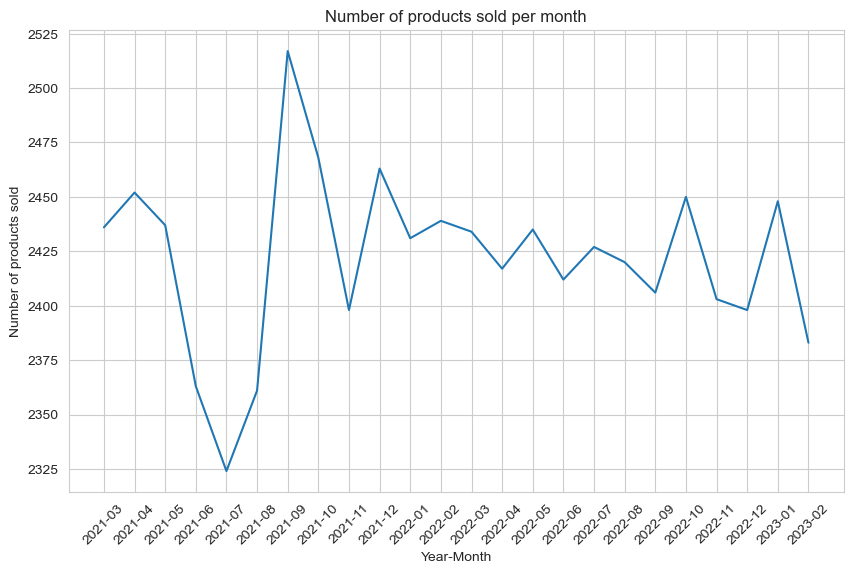

In [115]:
#nombre de produits vendus par mois
# Group by year and month and count the values  

products_per_month = Particulier_df.groupby('year_month')['id_prod'].nunique().reset_index()
products_per_month['year_month'] = products_per_month['year_month'].astype(str)

products_per_month = products_per_month[['year_month', 'id_prod']]
print(products_per_month)
# graphique du nombre de produits vendus par mois
# Create the line plot
plt.figure(figsize=(10,6))
sns.lineplot(x='year_month', y='id_prod', data=products_per_month)
plt.title('Number of products sold per month')
plt.xlabel('Year-Month')
plt.ylabel('Number of products sold')
plt.xticks(rotation=45)
plt.show()

     id_prod     price
3093   2_159  91097.76
3067   2_135  63470.80
3043   2_112  58785.90
3032   2_102  55650.74
2589   1_369  52897.95
2617   1_395  52182.00
3149   2_209  50742.75
2639   1_414  50376.62
2605   1_383  49746.84
3101   2_166  48308.40


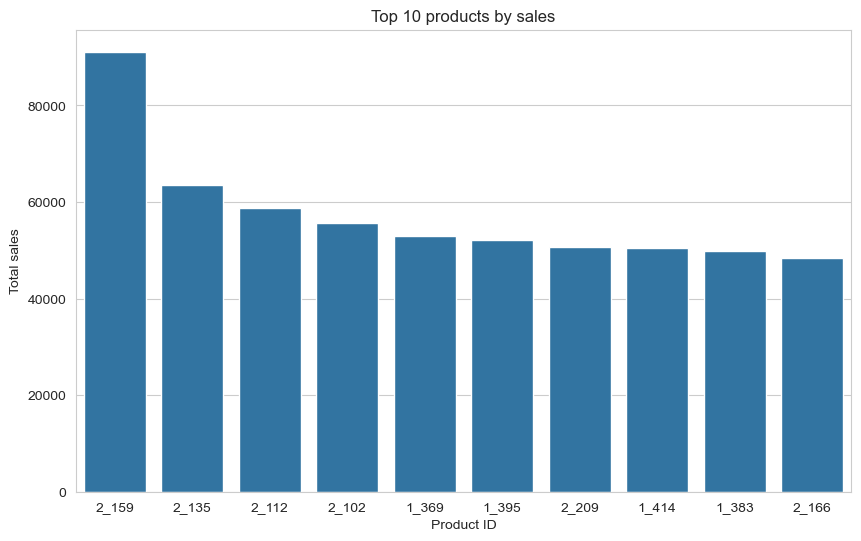

In [116]:
#le top 10 produits les plus vendus
# Group by product and sum the values
top_products = Particulier_df.groupby('id_prod')['price'].sum().reset_index().nlargest(10, 'price')
print(top_products)

# Create the bar chart
plt.figure(figsize=(10,6))
sns.barplot(x='id_prod', y='price', data=top_products)
plt.title('Top 10 products by sales')
plt.xlabel('Product ID')
plt.ylabel('Total sales')
plt.show()

     id_prod  price
209   0_1191   0.99
594   0_1539   0.99
312   0_1284   1.38
799   0_1726   1.57
718   0_1653   1.98
664   0_1601   1.99
958   0_1871   1.99
1783   0_541   1.99
2077   0_807   1.99
801   0_1728   2.27


Text(0.5, 1.0, 'Bottom 10 products by sales')

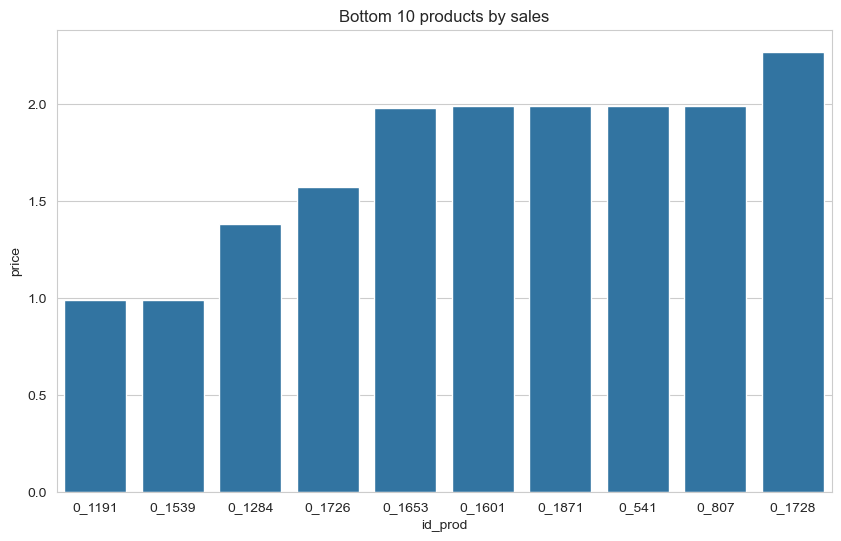

In [117]:
#le top 10 produits le moins vendus
# Group by product and sum the values
bottom_products = Particulier_df.groupby('id_prod')['price'].sum().reset_index().nsmallest(10, 'price')
print(bottom_products)

# Create the bar chart
plt.figure(figsize=(10,6))
sns.barplot(x='id_prod', y='price', data=bottom_products)

plt.title('Bottom 10 products by sales')

   categ       price
0    0.0  4119200.69
1    1.0  4520101.86
2    2.0  2504064.46


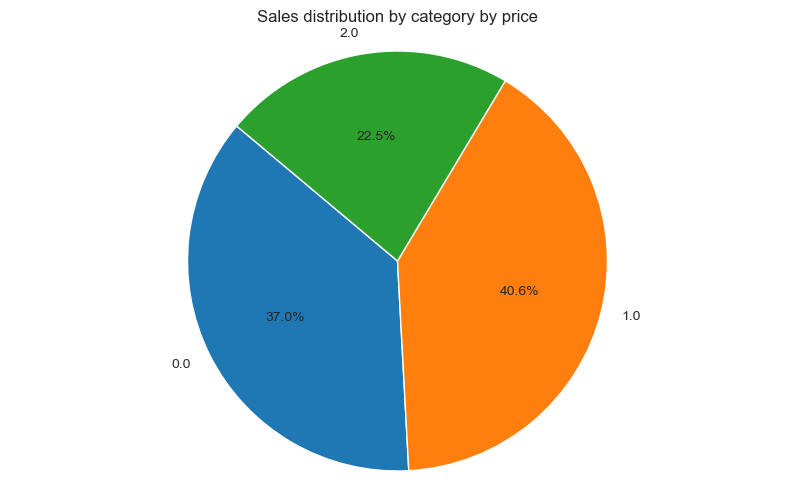

In [118]:
#la repartition par categorie des ventes
# Group by category and sum the values
category_sales = Particulier_df.groupby('categ')['price'].sum().reset_index()
print(category_sales)

# Create the pie chart
plt.figure(figsize=(10,6))
plt.pie(category_sales['price'], labels=category_sales['categ'], autopct='%1.1f%%', startangle=140)
plt.title('Sales distribution by category by price')
plt.axis('equal')
plt.show()



In [119]:
Particulier_df.head(3)


,client_id,sex,birth,id_prod,date,session_id,price,categ,age,year_month,month,year,week,day
0,c_1004,m,1973.0,0_0,2021-03-02 21:57:33.862118,s_908,3.75,0.0,48.0,2021-03,3,2021,9,2
1,c_1011,f,1999.0,0_0,2022-02-18 16:40:10.068303,s_167174,3.75,0.0,23.0,2022-02,2,2022,7,18
2,c_1011,f,1999.0,0_0,2022-03-18 16:40:10.068303,s_180968,3.75,0.0,23.0,2022-03,3,2022,11,18


Incide de Gini : 0.4


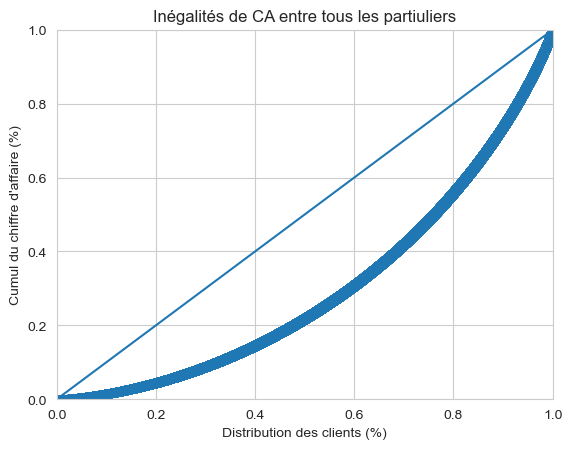

In [120]:
#courbe de lorenz 
#CA par client
# drop date
Particulier_ca = Particulier_df.drop(columns=['date', 'year', 'month', 'week', 'day', 'year_month'])
# Group by client and sum the values

CA_Client = Particulier_ca.groupby('client_id').sum()
CA_Client = CA_Client.rename(columns={'price':'CA'})
CA_Client = CA_Client['CA'].reset_index()
CA_Client.sort_values(by=["CA"], ascending=False)
# Courbe de Lorenz
def lorenz(variable, title):
    X = variable.values
    X = np.sort(X)
    
    # Indice de Gini
    def gini(array):
        array
        sorted_array = array.copy()
        sorted_array.sort()
        n = array.size
        coef_ = 2. / n
        const_ = (n + 1.) / n
        weighted_sum = sum([(i+1)*yi for i, yi in enumerate(sorted_array)])
        return coef_*weighted_sum/(sorted_array.sum()) - const_
    print('Incide de Gini :', round(gini(X), 2))
    
    # Courbe de Lorenz
    X_lorenz = X.cumsum() / X.sum()
    X_lorenz = np.insert(X_lorenz, 0, 0)
    # X_lorenz[0], X_lorenz[-1]
    y = np.arange(X_lorenz.size)/(X_lorenz.size-1)
    lorenz = pd.DataFrame()
    lorenz['X'] = pd.Series(X_lorenz)
    lorenz['Y'] = pd.Series(y)
    sns.scatterplot(data=lorenz, x='Y', y='X', marker='x')

    # Diagonale
    a = np.arange(0,1,.01)
    x = a
    y = a
    
    # Graphique
    sns.lineplot(x=x,y=y)
    plt.xlim([0,1])
    plt.ylim([0,1])
    plt.title(title)
    plt.xlabel("Distribution des clients (%)")
    plt.ylabel("Cumul du chiffre d'affaire (%)")
    plt.show()
    
lorenz(CA_Client['CA'], 'Inégalités de CA entre tous les partiuliers')

categ     0.0     1.0    2.0
sex                         
f      200793  115721  16980
m      186488  104884  15868


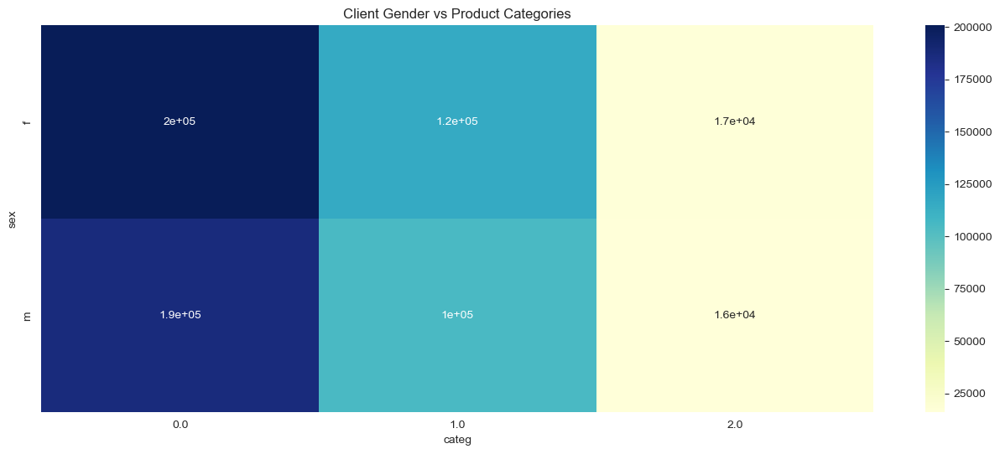

In [121]:
#le lien entre le genre d'un client et les catégories de produits qu'il a achetés
# Group by client and category and count the values
client_category = Particulier_df.groupby(['sex', 'categ'])['id_prod'].count().reset_index()
client_category = client_category.pivot(index='sex', columns='categ', values='id_prod').fillna(0)
print(client_category)

# Create the bar chart
plt.figure(figsize=(16,6))

sns.heatmap(client_category, annot=True, cmap='YlGnBu')

plt.title('Client Gender vs Product Categories')

plt.show()


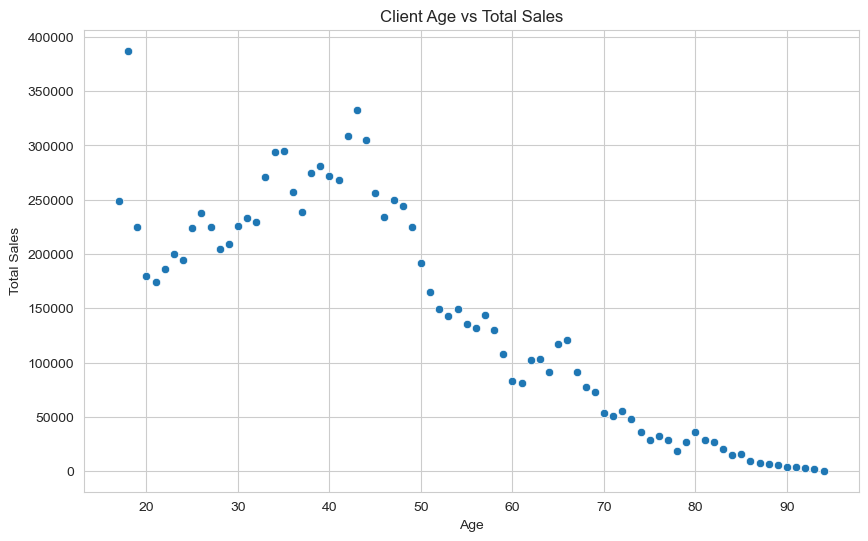

In [122]:
#le lien entre l'âge d'un client et le montant total des achats
# Group by client and sum the values
client_age = Particulier_df.groupby('age')['price'].sum().reset_index()

# Create the scatter plot
plt.figure(figsize=(10,6))
sns.scatterplot(x='age', y='price', data=client_age)
plt.title('Client Age vs Total Sales')
plt.xlabel('Age')
plt.ylabel('Total Sales')
plt.show()


C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\2076130925.py:3: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



categ       0.0    1.0    2.0
age                          
(0, 5]        0      0      0
(5, 10]       0      0      0
(10, 15]      0      0      0
(15, 20]   5668  10301  10161
(20, 25]   5584   9587   9534
(25, 30]  11007  11572  10007
(30, 35]  74263  23453    587
(35, 40]  74242  24466    367
(40, 45]  83339  26806    381
(45, 50]  62609  22081    346
(50, 55]  19351  24568    391
(55, 60]  14921  20173    299
(60, 65]  12902  16333    278
(65, 70]  10337  14083    221
(70, 75]   5736   7381     95


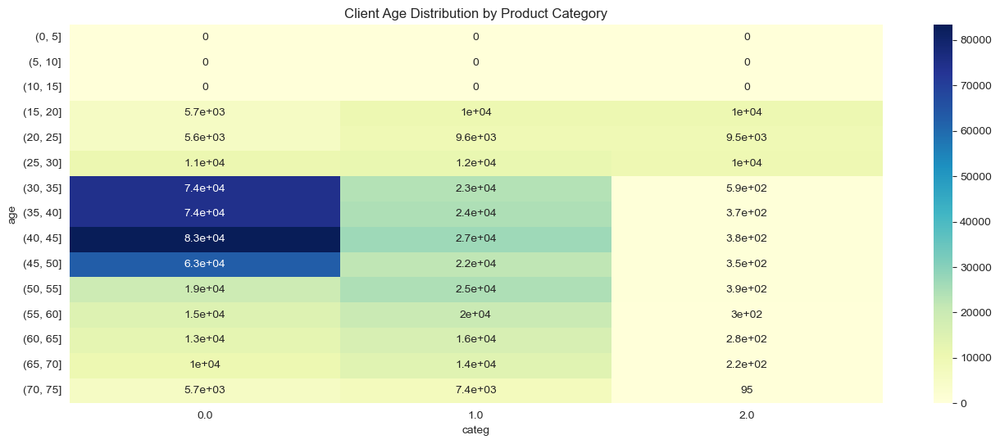

In [123]:
#la répartition par age des clients par catégorie de produits achetés
# Group by age by 5 years and category and count the values
df_grouped = Particulier_df.groupby([pd.cut(Particulier_df['age'], np.arange(0, 80, 5)), 'categ'])['client_id'].count().reset_index()
df_grouped = df_grouped.pivot(index='age', columns='categ', values='client_id').fillna(0)
print(df_grouped)
# Create a plot for each category
plt.figure(figsize=(16,6))
sns.heatmap(df_grouped, annot=True, cmap='YlGnBu')
plt.title('Client Age Distribution by Product Category')
plt.show()



     age  session_id
26  43.0       24757
25  42.0       23050
27  44.0       23046
18  35.0       22275
17  34.0       22151
..   ...         ...
73  90.0         243
74  91.0         222
75  92.0         197
76  93.0         129
77  94.0          23

[78 rows x 2 columns]


C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\3416541902.py:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




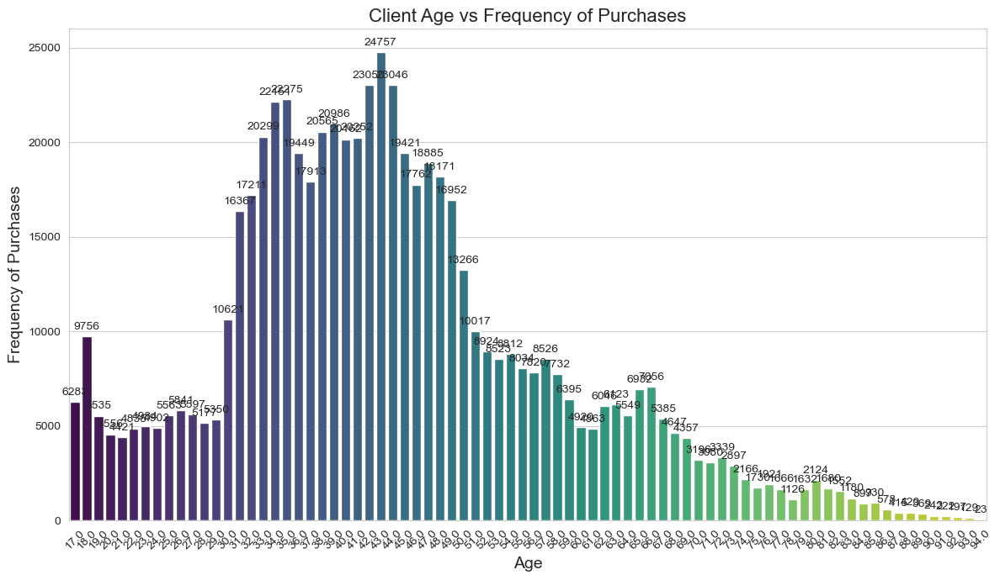

In [124]:
#le lien entre l'age des clients et la frequence d'achats
# Group by age and count the values
age_frequency = Particulier_df.groupby('age')['session_id'].count().reset_index()
# Sort the values in descending order
age_frequency = age_frequency.sort_values(by='session_id', ascending=False) 
print(age_frequency)
# Sort data by age
age_frequency_sorted = age_frequency.sort_values('age')
# Create the bar chart
plt.figure(figsize=(12, 7))
sns.set_style("whitegrid")
barplot = sns.barplot(
    x='age',
    y='session_id',
    data=age_frequency_sorted,
    palette='viridis'
)
plt.title('Client Age vs Frequency of Purchases', fontsize=16)
plt.xlabel('Age', fontsize=14)
plt.ylabel('Frequency of Purchases', fontsize=14)
plt.xticks(rotation=45)

# Add value labels
for p in barplot.patches:
    barplot.annotate(
        format(p.get_height(), '.0f'),
        (p.get_x() + p.get_width() / 2., p.get_height()),
        ha='center', va='center',
        xytext=(0, 8),
        textcoords='offset points'
    )

plt.tight_layout()
plt.show()

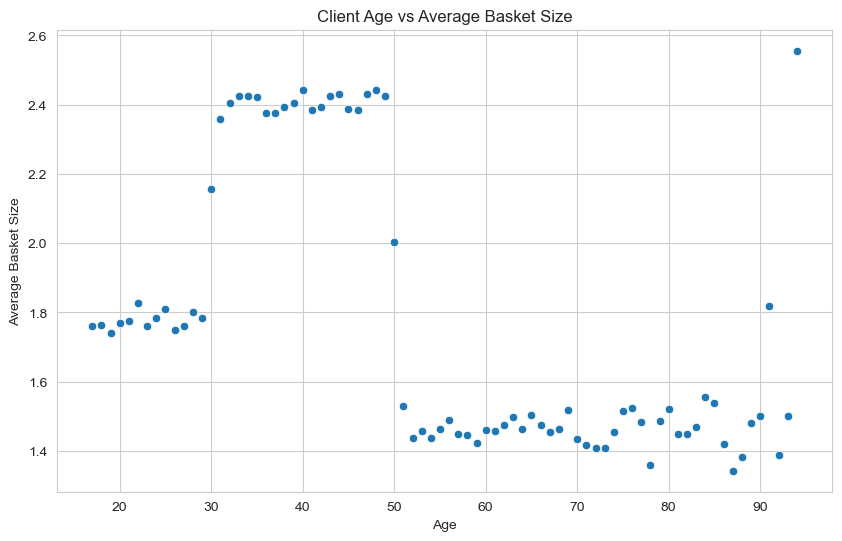

In [125]:
# Calculate the basket size for each session
basket_size = Particulier_df.groupby('session_id')['id_prod'].count().reset_index()
basket_size = basket_size.rename(columns={'id_prod': 'basket_size'})

# Merge the basket size with client data
client_sessions = Particulier_df[['session_id', 'client_id', 'age']].drop_duplicates()
average_basket_size = pd.merge(client_sessions, basket_size, on='session_id')

# Calculate the average basket size for each client by age
average_basket_size = average_basket_size.groupby(['age'])['basket_size'].mean().reset_index()


# Create the scatter plot
plt.figure(figsize=(10,6))
sns.scatterplot(x='age', y='basket_size', data=average_basket_size)

plt.title('Client Age vs Average Basket Size')
plt.xlabel('Age')
plt.ylabel('Average Basket Size')
plt.show()



In [126]:
#average basker size
average_basket_size.mean()

age            55.500000
basket_size     1.778893
dtype: float64

## Etape 6 - Analyse pro

In [127]:
# evolution of money spent over time by the rest of the clients (excluding the top 4)

evolution_df_pro = pro_df.groupby(['date'])['price'].sum().reset_index()
fig = px.line(evolution_df_pro, x='date', y='price', title='Evolution of money spent by profesionals over time')
fig.show()

In [128]:
# Convert 'date' column to datetime
pro_df['date'] = pd.to_datetime(pro_df['date'])

# Extract year and month for grouping
pro_df['year_month'] = pro_df['date'].dt.to_period('M')

# Group by year and month and sum the values
evolution_df_pro2 = pro_df.groupby('year_month')['price'].sum().reset_index()
evolution_df_pro2['year_month'] = evolution_df_pro2['year_month'].astype(str)

# Create the line plot
fig = px.line(evolution_df_pro2, x='year_month', y='price', title='Evolution of money spent by month')
fig.show()

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\1144694371.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\1144694371.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [129]:
# evolution of money spent over time by the rest of the clients by month 
pro_df['date'] = pd.to_datetime(pro_df['date'])
pro_df['month'] = pro_df['date'].dt.month
pro_df['year'] = pro_df['date'].dt.year

evolution_df_month_pro = pro_df.groupby(['year','month'])['price'].sum().reset_index()

fig = px.line(evolution_df_month_pro, x='month', y='price', color='year', title='Evolution of money spent by filtered clients over time by month')

fig.show()

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\1438076159.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\1438076159.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\1438076159.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

In [130]:
# chiffre d'affaires par annee et par mois et par semaine
pro_df['date'] = pd.to_datetime(pro_df['date'])
pro_df['year'] = pro_df['date'].dt.year
pro_df['month'] = pro_df['date'].dt.month
pro_df['week'] = pro_df['date'].dt.isocalendar().week
pro_df['day'] = pro_df['date'].dt.day

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\648630697.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\648630697.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\648630697.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs

In [131]:


# sum of price by year
chiffre_affaires_year = pro_df.groupby(['year'])['price'].sum().reset_index()   
chiffre_affaires_year.head(3)


,year,price
0,2021,359784.84
1,2022,453260.88
2,2023,71250.37


In [132]:
# sum of price by month
chiffre_affaires_month = pro_df.groupby(['year', 'month'])['price'].sum().reset_index()
chiffre_affaires_month.head(50) 

,year,month,price
0,2021,3,36521.90
1,2021,4,36771.45
2,2021,5,38056.01
3,2021,6,36986.39
4,2021,7,35242.25
5,2021,8,36282.49
6,2021,9,36318.88
7,2021,10,27335.94
8,2021,11,38075.65
9,2021,12,38193.88


In [133]:

# sum of price by week
chiffre_affaires_week = pro_df.groupby(['year', 'month', 'week'])['price'].sum().reset_index()
chiffre_affaires_week.head(120)

,year,month,week,price
0,2021,3,9,8219.27
1,2021,3,10,7863.32
2,2021,3,11,8005.34
3,2021,3,12,8336.64
4,2021,3,13,4097.33
...,...,...,...,...
115,2023,1,1,9018.36
116,2023,1,2,7232.88
117,2023,1,3,7407.94
118,2023,1,4,8102.02


   categ      price
0    0.0  300530.28
1    1.0  307555.25
2    2.0  276210.56


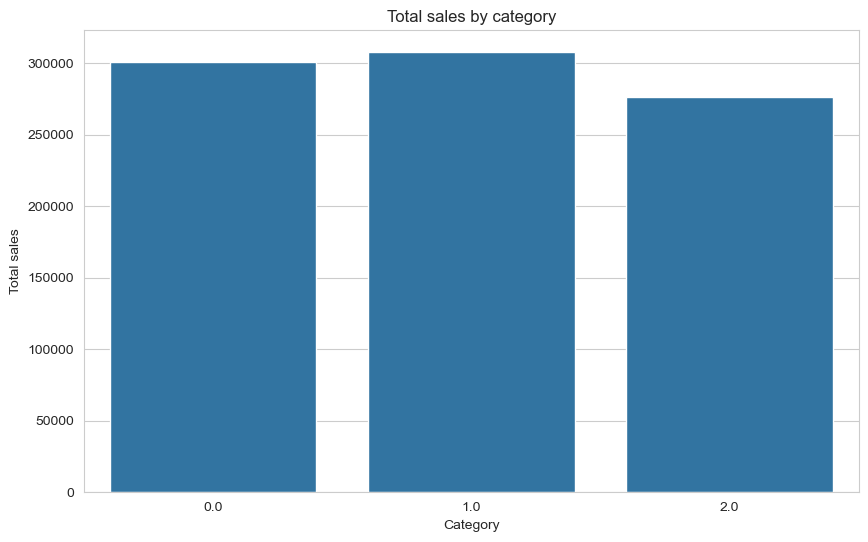

In [134]:
#chiffre d'affaires par categorie
# Group by category and sum the values
category_sales = pro_df.groupby('categ')['price'].sum().reset_index()
print(category_sales)

# Create the bar chart
plt.figure(figsize=(10,6))
sns.barplot(x='categ', y='price', data=category_sales)
plt.title('Total sales by category')
plt.xlabel('Category')
plt.ylabel('Total sales')
plt.show()

   year_month  client_id
0     2021-03          4
1     2021-04          4
2     2021-05          4
3     2021-06          4
4     2021-07          4
5     2021-08          4
6     2021-09          4
7     2021-10          4
8     2021-11          4
9     2021-12          4
10    2022-01          4
11    2022-02          4
12    2022-03          4
13    2022-04          4
14    2022-05          4
15    2022-06          4
16    2022-07          4
17    2022-08          4
18    2022-09          4
19    2022-10          4
20    2022-11          4
21    2022-12          4
22    2023-01          4
23    2023-02          4


C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\1294902612.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



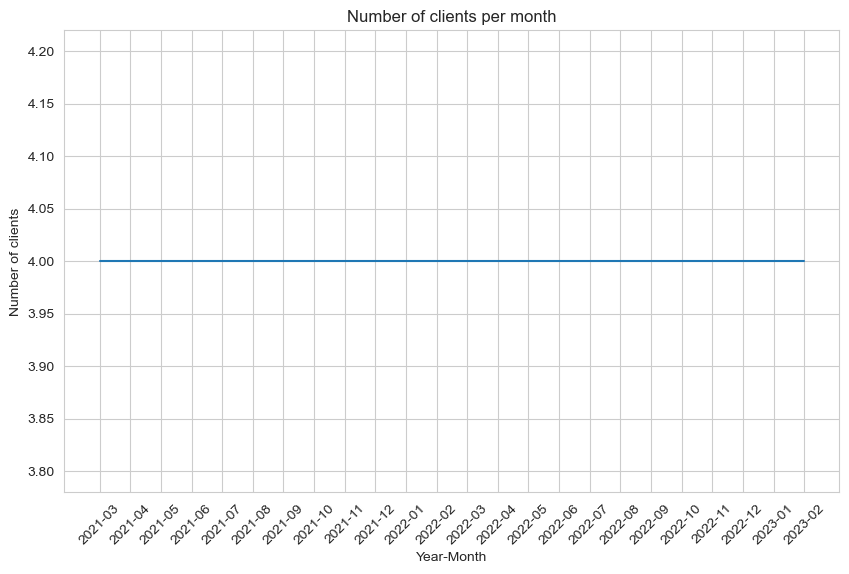

In [135]:
# nombre de clients par mois 
# Extract year and month for grouping
pro_df['year_month'] = pro_df['date'].dt.to_period('M')

# Group by year and month and count the values
clients_per_month_pro2 = pro_df.groupby('year_month')['client_id'].nunique().reset_index()
clients_per_month_pro2['year_month'] = clients_per_month_pro2['year_month'].astype(str)
print(clients_per_month_pro2)

# Create the line plot
plt.figure(figsize=(10,6))
sns.lineplot(x='year_month', y='client_id', data=clients_per_month_pro2)
plt.title('Number of clients per month')
plt.xlabel('Year-Month')
plt.ylabel('Number of clients')
plt.xticks(rotation=45)
plt.show()

   year_month  session_id
0     2021-03        1954
1     2021-04        1973
2     2021-05        2013
3     2021-06        1812
4     2021-07        1663
5     2021-08        1695
6     2021-09        2339
7     2021-10        1709
8     2021-11        1992
9     2021-12        2249
10    2022-01        1927
11    2022-02        2025
12    2022-03        1993
13    2022-04        1943
14    2022-05        2029
15    2022-06        2025
16    2022-07        1955
17    2022-08        1922
18    2022-09        1919
19    2022-10        1950
20    2022-11        1922
21    2022-12        2100
22    2023-01        1919
23    2023-02        1772


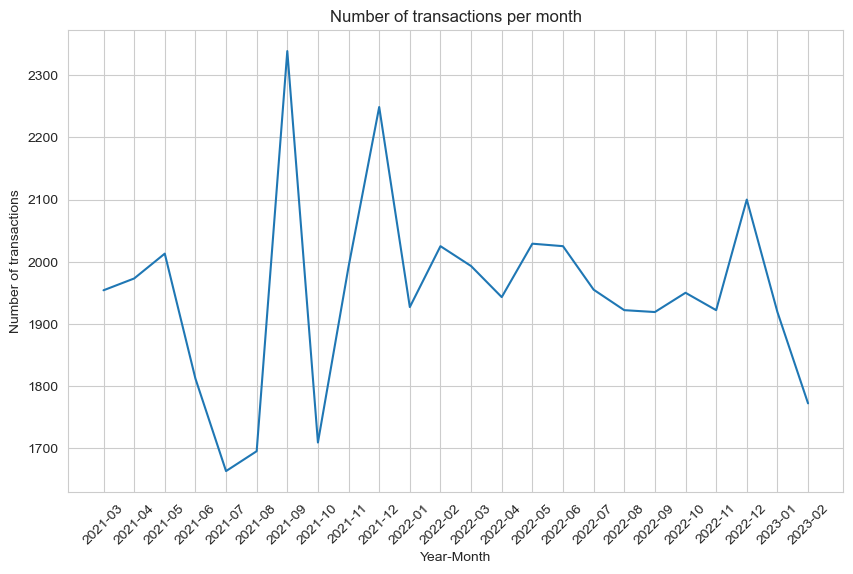

In [136]:
#nombre de transactions par mois
# Group by year and month and count the values
transactions_per_month = pro_df.groupby('year_month')['session_id'].count().reset_index()
transactions_per_month['year_month'] = transactions_per_month['year_month'].astype(str)

transactions_per_month = transactions_per_month[['year_month', 'session_id']]
print(transactions_per_month) 
# graphique du nombre de transactions par mois
# Create the line plot
plt.figure(figsize=(10,6))
sns.lineplot(x='year_month', y='session_id', data=transactions_per_month)
plt.title('Number of transactions per month')
plt.xlabel('Year-Month')
plt.ylabel('Number of transactions')
plt.xticks(rotation=45) 
plt.show()

   year_month  id_prod
0     2021-03      984
1     2021-04      986
2     2021-05      973
3     2021-06      958
4     2021-07      879
5     2021-08      890
6     2021-09     1058
7     2021-10      906
8     2021-11      971
9     2021-12     1015
10    2022-01      926
11    2022-02      967
12    2022-03      978
13    2022-04      980
14    2022-05     1015
15    2022-06      976
16    2022-07      954
17    2022-08      939
18    2022-09      946
19    2022-10      947
20    2022-11      947
21    2022-12     1002
22    2023-01      970
23    2023-02      922


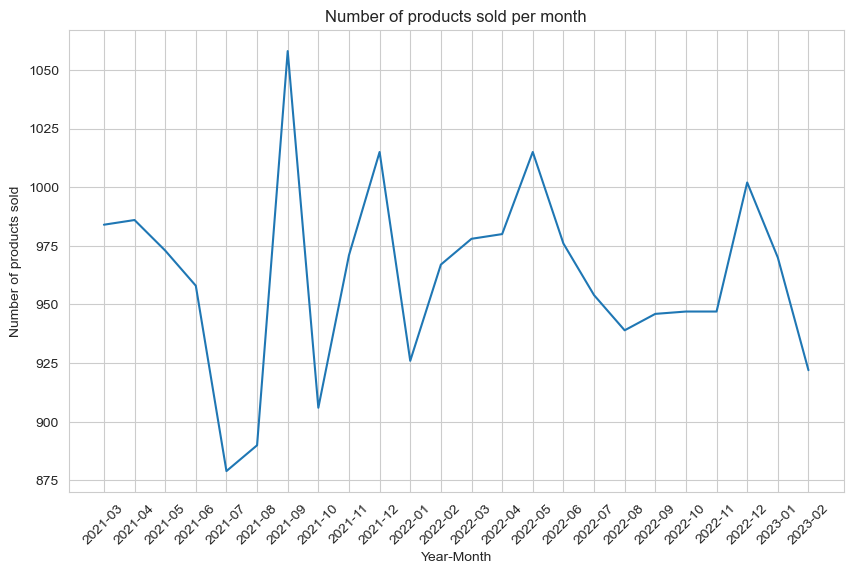

In [137]:
#nombre de produits vendus par mois
# Group by year and month and count the values  

products_per_month = pro_df.groupby('year_month')['id_prod'].nunique().reset_index()
products_per_month['year_month'] = products_per_month['year_month'].astype(str)

products_per_month = products_per_month[['year_month', 'id_prod']]
print(products_per_month)
# graphique du nombre de produits vendus par mois
# Create the line plot
plt.figure(figsize=(10,6))
sns.lineplot(x='year_month', y='id_prod', data=products_per_month)
plt.title('Number of products sold per month')
plt.xlabel('Year-Month')
plt.ylabel('Number of products sold')
plt.xticks(rotation=45)
plt.show()

     id_prod    price
2190   2_112  6621.86
2281   2_209  6229.11
2188   2_110  5976.00
2207   2_135  5864.15
2320    2_39  5567.04
2318    2_37  5339.91
2181   2_102  5086.04
2280   2_208  4883.43
2186   2_109  4859.10
2241   2_167  4739.80


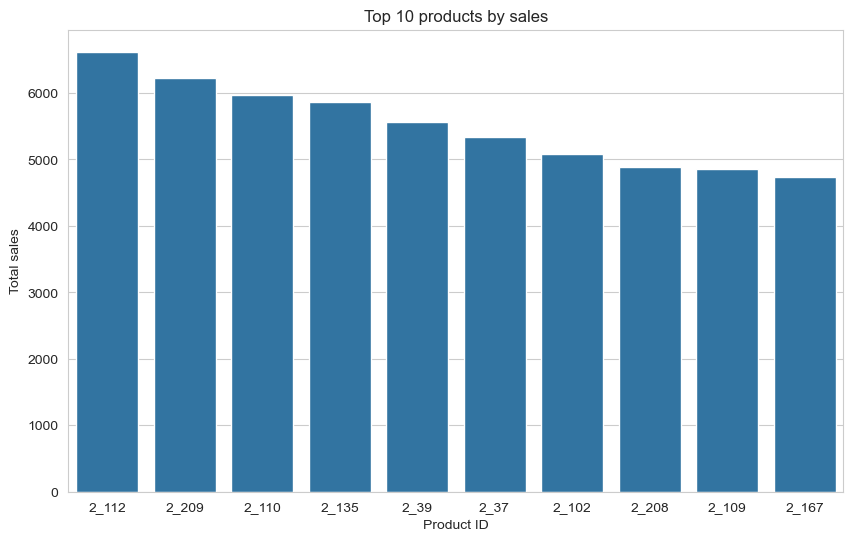

In [138]:
#le top 10 produits les plus vendus
# Group by product and sum the values
top_products = pro_df.groupby('id_prod')['price'].sum().reset_index().nlargest(10, 'price')
print(top_products)

# Create the bar chart
plt.figure(figsize=(10,6))
sns.barplot(x='id_prod', y='price', data=top_products)
plt.title('Top 10 products by sales')
plt.xlabel('Product ID')
plt.ylabel('Total sales')
plt.show()

     id_prod  price
1357   0_528   0.62
812   0_1935   0.99
12    0_1010   1.96
153    0_118   1.98
165   0_1191   1.98
756   0_1871   1.99
1405   0_587   1.99
1127  0_2288   2.06
1215    0_32   2.14
457   0_1510   2.18


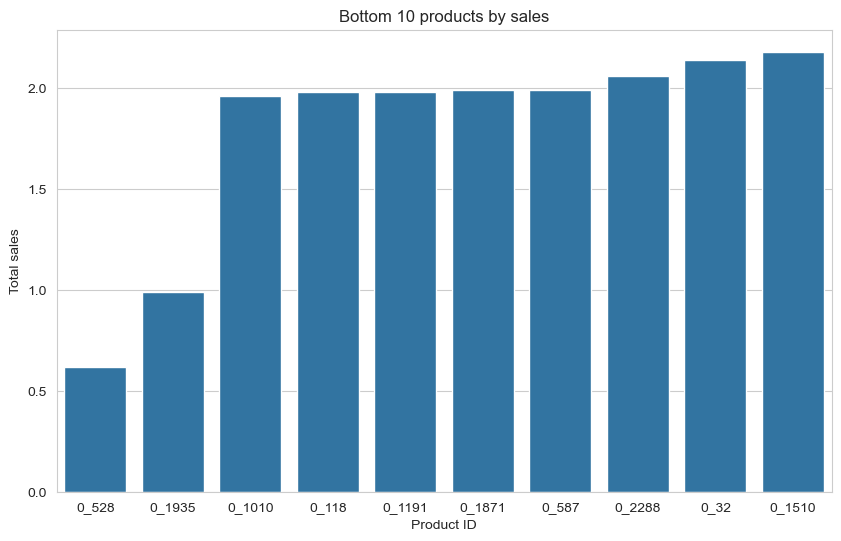

In [139]:
#le top 10 produits le moins vendus
# Group by product and sum the values
bottom_products = pro_df.groupby('id_prod')['price'].sum().reset_index().nsmallest(10, 'price')
print(bottom_products)

# Create the bar chart
plt.figure(figsize=(10,6))
sns.barplot(x='id_prod', y='price', data=bottom_products)
plt.title('Bottom 10 products by sales')
plt.xlabel('Product ID')
plt.ylabel('Total sales')
plt.show()



## Etape 7 - analyse statistique

### Analyse 1 : Relation entre le genre des clients et les catégories de livres achetées (Test du Chi-Carré)



Pour étudier la relation entre le genre des clients (H/F) et les catégories de livres achetées (0, 1 ou 2), le test le plus approprié serait le test du Chi carré pour les tableaux de contingence. Voici pourquoi :

Pourquoi utiliser le test du Chi carré ?
Nature des données :

Le genre (H/F) est une variable qualitative nominale.

Les catégories de livres (0, 1, 2) sont également qualitatives, même si elles sont numérotées.

Objectif :

Ce test examine s'il existe une association ou une indépendance entre deux variables qualitatives.

Conditions à respecter :
Échantillon suffisant :

Les fréquences attendues dans chaque cellule du tableau de contingence doivent être supérieures à 5 pour que le test soit valide.

Indépendance des observations :

Chaque achat par un client doit être indépendant des autres.

In [140]:

# Chi-Square Test is used to determine the association between two categorical variables.
# In this case, we test whether customer gender is significantly associated with book categories purchased.
contingency_table = pd.crosstab(Particulier_df['sex'], Particulier_df['categ'])


In [141]:
# Perform Chi-Square test
chi2, p, dof, expected = chi2_contingency(contingency_table)
print("Chi-Square Statistic:", chi2)
print("P-value:", p)
alpha = 0.05
if p < alpha:
    print(f"Il existe une relation significative entre le genre et la catégorie de livres (p-value = {p:.4f}, alpha = {alpha}).")
else:
    print(f"Aucune relation significative détectée (p-value = {p:.4f}, alpha = {alpha}).")

Chi-Square Statistic: 22.66856665178056
P-value: 1.1955928116587024e-05
Il existe une relation significative entre le genre et la catégorie de livres (p-value = 0.0000, alpha = 0.05).


Tableau de contingence :
categ     0.0     1.0    2.0
sex                         
f      200793  115721  16980
m      186488  104884  15868
2


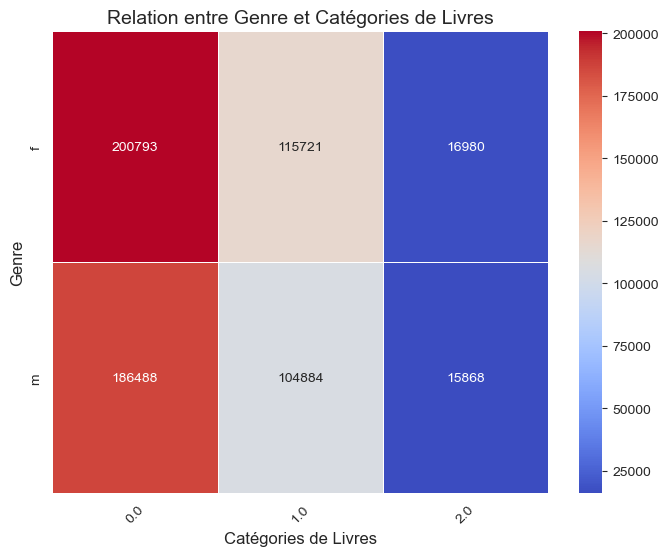

In [142]:
# Affichage du tableau de contingence
print("Tableau de contingence :")
print(contingency_table)
print(dof)


plt.figure(figsize=(8, 6))
sns.heatmap(contingency_table, annot=True, fmt="d", cmap="coolwarm", cbar=True, linewidths=0.5)
plt.title("Relation entre Genre et Catégories de Livres", fontsize=14)
plt.xlabel("Catégories de Livres", fontsize=12)
plt.ylabel("Genre", fontsize=12)
plt.xticks(rotation=45)
plt.show()

#### **Chi-Square Statistic (χ²)**
This value represents the discrepancy between observed and expected frequencies in your contingency table. A larger Chi-Square statistic suggests a greater difference between the expected values (if there were no association) and the actual values in your data.

##### **Degrees of Freedom (dof)**
This is calculated as:
\[
\text{dof} = (\text{Rows} - 1) \times (\text{Columns} - 1)
\]
It helps determine the shape of the Chi-Square distribution used to assess significance.

##### **P-Value**
The p-value indicates the probability of observing a Chi-Square statistic at least as extreme as yours if there were truly no relationship (i.e., under the null hypothesis). 

- If **p < 0.05**, you reject the null hypothesis, meaning there **is** evidence of a significant relationship between gender and book categories.
- If **p ≥ 0.05**, you **fail to reject** the null hypothesis, meaning there **is no strong evidence** of an association.

##### **Practical Interpretation**
If your p-value is below 0.05, it suggests that book category preferences differ **significantly** by gender. If the p-value is higher, the differences observed could just be due to random chance rather than a true relationship.




### Analyse 2 : Relation entre l'âge des clients et le montant total des achats (Corrélation de Pearson/spearman)



Pour analyser la relation entre l'âge des clients (variable quantitative continue) et le montant total des achats (variable également quantitative continue), le test de corrélation de Pearson serait le meilleur choix, à condition que les données respectent les hypothèses suivantes :

Pourquoi utiliser le test de corrélation de Pearson ?
Objectif : Ce test mesure la force et la direction de la relation linéaire entre deux variables quantitatives.

Hypothèses nécessaires :

La relation entre les variables est supposée linéaire.

Les deux variables suivent une distribution normale (testable avec Shapiro-Wilk ou Kolmogorov-Smirnov).

Les observations sont indépendantes.

Cas où le test de Pearson n’est pas approprié :
Si les données ne respectent pas l'hypothèse de normalité ou si la relation entre les variables est non linéaire, le test de corrélation de Spearman (non-paramétrique) est une alternative robuste.

Interprétation des résultats du test de Pearson :
Coefficient de corrélation (r) :

𝑟
 proche de +1 : Forte corrélation positive (ex : avec l'âge, les achats augmentent).

𝑟
 proche de -1 : Forte corrélation négative (ex : avec l'âge, les achats diminuent).

𝑟
 proche de 0 : Aucune corrélation linéaire.

P-value : Si elle est inférieure à 0.05, la relation est statistiquement significative.

In [143]:
# Regrouper l'âge par année (convertir les valeurs en entiers)
Particulier_df['age_year'] = Particulier_df['age'].astype(int)  # Convertir l'âge en années complètes

C:\Users\SKIKK\AppData\Local\Temp\ipykernel_5756\1355201654.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [144]:
# Regrouper par ID client et totaliser les achats
client_totals = Particulier_df.groupby('age')['price'].sum()


In [145]:
# Regrouper par âge_années au lieu de l'âge brut
age_group = Particulier_df.groupby('age_year')['price'].sum()


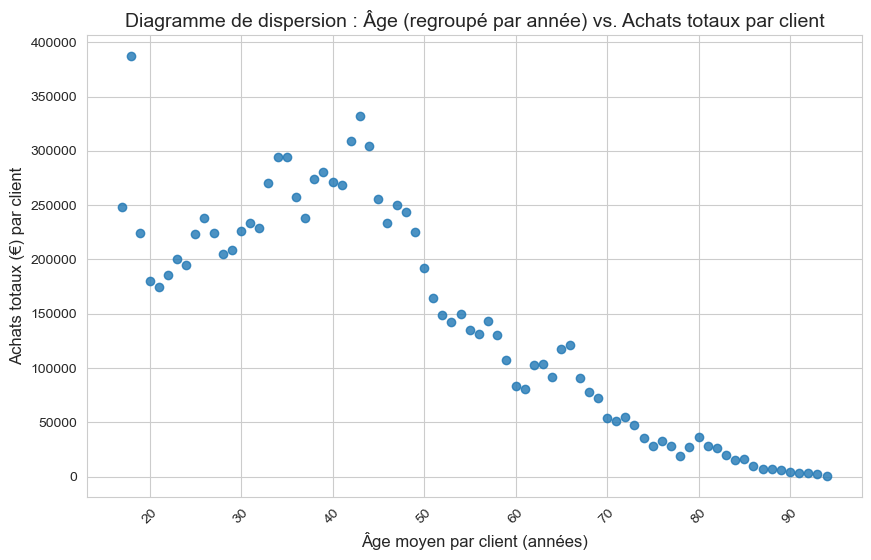

In [146]:
# Diagramme de dispersion avec ligne de régression (en utilisant l'âge regroupé)
plt.figure(figsize=(10, 6))
sns.regplot(x=Particulier_df.groupby('age')['age_year'].mean(), 
            y=client_totals, fit_reg=False)
plt.title('Diagramme de dispersion : Âge (regroupé par année) vs. Achats totaux par client', fontsize=14)
plt.xlabel('Âge moyen par client (années)', fontsize=12)
plt.ylabel('Achats totaux (€) par client', fontsize=12)
plt.xticks(rotation=45)
plt.show()

In [147]:
#Regrouper par client_id et calculer l'âge moyen et le total des achats pour chaque client
client_stats = Particulier_df.groupby('client_id').agg({
    'age': 'mean',         # âge moyen du client (au cas où il y a plusieurs lignes par client)
    'price': 'sum'         # total des achats du client
}).reset_index()

# Test de normalité sur l'âge et le total des achats par client
age_stat, age_p = normaltest(client_stats['age'])
price_stat, price_p = normaltest(client_stats['price'])

print(f"Test de D'Agostino-Pearson pour l'âge (par client) : p-valeur = {age_p:.4f}")
print(f"Test de D'Agostino-Pearson pour le total des achats (par client) : p-valeur = {price_p:.4f}")

print("L'âge (par client) est " + ("normalement distribué." if age_p > 0.05 else "pas normalement distribué."))
print("Le total des achats (par client) est " + ("normalement distribué." if price_p > 0.05 else "pas normalement distribué."))

# Choisir le test de corrélation approprié
correlation_test = pearsonr if (age_p > 0.05 and price_p > 0.05) else spearmanr
correlation, p_value = correlation_test(client_stats['age'], client_stats['price'])
test_name = "Pearson" if correlation_test == pearsonr else "Spearman"

print(f"Coefficient de corrélation de {test_name} : {correlation:.4f}")
print(f"P-valeur ({test_name}) : {p_value:.4f}")

if p_value < 0.05:
    print(f"Une relation significative existe entre l'âge du client et le total de ses achats (p-valeur = {p_value:.4f}).")
else:
    print(f"Aucune relation significative trouvée (p-valeur = {p_value:.4f}).")


Test de D'Agostino-Pearson pour l'âge (par client) : p-valeur = 0.0000
Test de D'Agostino-Pearson pour le total des achats (par client) : p-valeur = 0.0000
L'âge (par client) est pas normalement distribué.
Le total des achats (par client) est pas normalement distribué.
Coefficient de corrélation de Spearman : -0.1805
P-valeur (Spearman) : 0.0000
Une relation significative existe entre l'âge du client et le total de ses achats (p-valeur = 0.0000).


### Analyse 3 : Relation entre l'âge des clients et la fréquence des achats (Corrélation de Pearson/Spearman)


Pour analyser la relation entre l'âge des clients (variable quantitative continue) et la fréquence des achats (également une variable quantitative continue), le test de corrélation de Pearson serait le meilleur choix à condition que les données respectent les hypothèses nécessaires. Voici pourquoi et les étapes nécessaires :

Pourquoi choisir le test de corrélation de Pearson ?
Objectif : Ce test mesure la force et la direction de la relation linéaire entre deux variables quantitatives.

Hypothèses nécessaires :

Les deux variables doivent suivre une distribution normale.

La relation entre les deux variables est supposée linéaire.

Les observations doivent être indépendantes.

Si les hypothèses ne sont pas respectées (par exemple, les données ne suivent pas une distribution normale), le test de corrélation de Spearman serait une meilleure alternative, car il ne nécessite pas de normalité ni de linéarité.

In [148]:
# Étape 1 : Regrouper par âge et calculer la fréquence des achats
age_frequency = Particulier_df.groupby('age')['session_id'].count().reset_index()
age_frequency = age_frequency.rename(columns={'session_id': 'purchase_frequency'})

<Axes: xlabel='age', ylabel='purchase_frequency'>

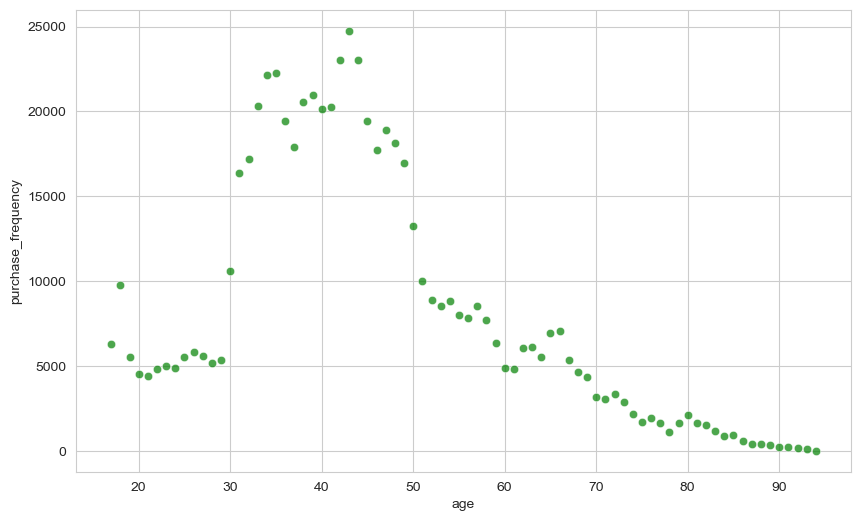

In [149]:
# Ajuster une ligne de régression uniquement si les données sont linéaires (Lowess gère bien les tendances non linéaires)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=age_frequency['age'], y=age_frequency['purchase_frequency'], color='green', alpha=0.7)


In [150]:
# Étape 1 : Regrouper par client_id et calculer l'âge moyen et la fréquence des achats (nombre de sessions) pour chaque client
client_frequency = Particulier_df.groupby('client_id').agg({
    'age': 'mean',                # âge moyen du client
    'session_id': 'count'         # fréquence des achats (nombre de sessions)
}).reset_index()
client_frequency = client_frequency.rename(columns={'session_id': 'purchase_frequency'})

# Étape 2 : Tester la normalité avec le test de D'Agostino-Pearson
age_stat, age_p = normaltest(client_frequency['age'])  
freq_stat, freq_p = normaltest(client_frequency['purchase_frequency'])

print("Test de D'Agostino-Pearson pour l'âge (par client) : p-valeur =", age_p)
print("Test de D'Agostino-Pearson pour la fréquence des achats (par client) : p-valeur =", freq_p)

if age_p > 0.05:
    print("L'âge (par client) est approximativement distribué normalement.")
else:
    print("L'âge (par client) n'est pas distribué normalement.")

if freq_p > 0.05:
    print("La fréquence des achats (par client) est approximativement distribuée normalement.")
else:
    print("La fréquence des achats (par client) n'est pas distribuée normalement.")

# Étape 3 : Effectuer le test de corrélation en fonction de la normalité
if age_p > 0.05 and freq_p > 0.05:
    # Les deux variables sont normales ; utiliser la corrélation de Pearson
    correlation, p_value = pearsonr(client_frequency['age'], client_frequency['purchase_frequency'])
    print("\nCoefficient de corrélation de Pearson :", correlation)
    print("P-valeur (Pearson) :", p_value)
else:
    # Utiliser la corrélation de Spearman pour les données non normales
    correlation, p_value = spearmanr(client_frequency['age'], client_frequency['purchase_frequency'])
    print("\nCoefficient de corrélation de Spearman :", correlation)
    print("P-valeur (Spearman) :", p_value)

if p_value < 0.05:
    print("Une corrélation significative a été trouvée entre l'âge du client et la fréquence de ses achats.")
else:
    print("Aucune corrélation significative n'a été trouvée entre l'âge du client et la fréquence de ses achats.")

Test de D'Agostino-Pearson pour l'âge (par client) : p-valeur = 2.577856867373919e-110
Test de D'Agostino-Pearson pour la fréquence des achats (par client) : p-valeur = 0.0
L'âge (par client) n'est pas distribué normalement.
La fréquence des achats (par client) n'est pas distribuée normalement.

Coefficient de corrélation de Spearman : 0.13126919211746624
P-valeur (Spearman) : 2.3799432474646066e-34
Une corrélation significative a été trouvée entre l'âge du client et la fréquence de ses achats.



### Analyse 4 : Relation entre l'âge des clients et la taille moyenne du panier (Corrélation de Pearson/spearman)


Pour analyser la relation entre l'âge des clients (variable quantitative continue) et la taille moyenne du panier (€), le test de corrélation de Pearson serait idéal si les données respectent les hypothèses de normalité et de linéarité. Voici une explication détaillée :

Pourquoi utiliser le test de corrélation de Pearson ?
Objectif : Le test mesure la force et la direction d'une relation linéaire entre deux variables quantitatives.

Hypothèses nécessaires :

Les deux variables doivent être normalement distribuées.

La relation entre les deux variables doit être linéaire.

Les observations doivent être indépendantes.

Si ces hypothèses ne sont pas respectées (par exemple, si les données ne sont pas normalement distribuées ou si la relation est non linéaire), le test de corrélation de Spearman est une alternative robuste. Ce test évalue une relation monotone (croissante ou décroissante), sans exiger normalité.

In [151]:

# Étape 1 : Calculer la taille du panier pour chaque session
basket_size = Particulier_df.groupby('session_id')['price'].sum().reset_index()
basket_size = basket_size.rename(columns={'price': 'basket_size'})


In [152]:
# Étape 2 : Fusionner la taille du panier avec les données des clients
client_sessions = Particulier_df[['session_id', 'client_id', 'age']].drop_duplicates()
average_basket_size = pd.merge(client_sessions, basket_size, on='session_id')

# Calculer la taille moyenne du panier pour chaque client par âge
average_basket_size = average_basket_size.groupby(['age'])['basket_size'].mean().reset_index()

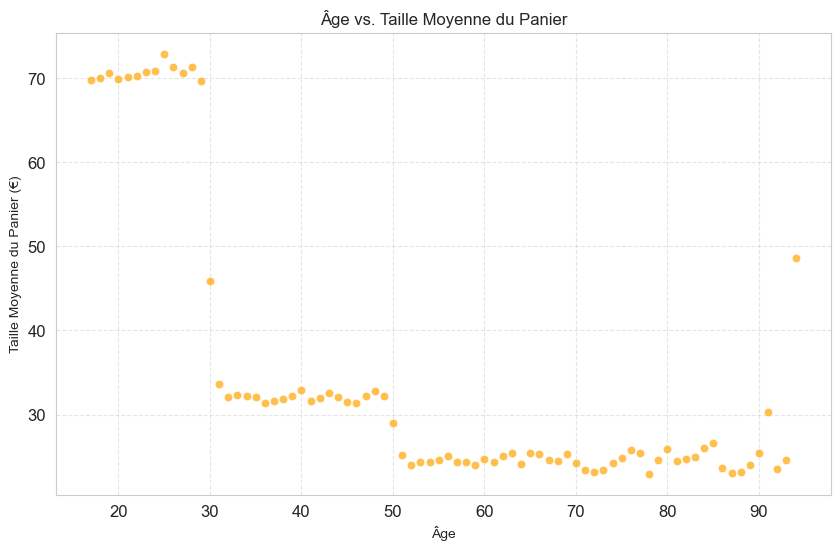

In [153]:
# Étape 5 : Visualiser la relation avec un diagramme de dispersion et une ligne de régression
plt.figure(figsize=(10, 6))
sns.scatterplot(x=average_basket_size['age'], y=average_basket_size['basket_size'], color='orange', alpha=0.7)
plt.title('Âge vs. Taille Moyenne du Panier')
plt.xlabel('Âge')
plt.ylabel('Taille Moyenne du Panier (€)')
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)

In [154]:
# Étape 1 : Calculer la taille du panier moyen pour chaque client
basket_size = Particulier_df.groupby('session_id')['price'].sum().reset_index()
basket_size = basket_size.rename(columns={'price': 'basket_size'})

# Fusionner la taille du panier avec les données des clients
client_sessions = Particulier_df[['session_id', 'client_id', 'age']].drop_duplicates()
basket_client = pd.merge(client_sessions, basket_size, on='session_id')

# Calculer la taille moyenne du panier pour chaque client (et l'âge moyen du client)
average_basket_size = basket_client.groupby('client_id').agg({
    'age': 'mean',
    'basket_size': 'mean'
}).reset_index()

# Étape 3 : Tester la normalité
age_stat, age_p = normaltest(average_basket_size['age'])  
basket_stat, basket_p = normaltest(average_basket_size['basket_size'])

print("Test de D'Agostino-Pearson pour l'âge (par client) : p-valeur =", age_p)
print("Test de D'Agostino-Pearson pour la taille moyenne du panier (par client) : p-valeur =", basket_p)

print("L'âge (par client) est " + ("approximativement distribué normalement." if age_p > 0.05 else "pas distribué normalement."))
print("La taille moyenne du panier (par client) est " + ("approximativement distribuée normalement." if basket_p > 0.05 else "pas distribuée normalement."))

# Étape 4 : Choisir le test de corrélation approprié
if age_p > 0.05 and basket_p > 0.05:
    correlation, p_value = pearsonr(average_basket_size['age'], average_basket_size['basket_size'])
    print("\nCoefficient de corrélation de Pearson :", correlation)
    print("P-valeur (Pearson) :", p_value)
else:
    correlation, p_value = spearmanr(average_basket_size['age'], average_basket_size['basket_size'])
    print("\nCoefficient de corrélation de Spearman :", correlation)
    print("P-valeur (Spearman) :", p_value)

if p_value < 0.05:
    print("Une corrélation significative a été trouvée entre l'âge du client et la taille moyenne de son panier.")
else:
    print("Aucune corrélation significative n'a été trouvée entre l'âge du client et la taille moyenne de son panier.")



Test de D'Agostino-Pearson pour l'âge (par client) : p-valeur = 2.9388952272711223e-110
Test de D'Agostino-Pearson pour la taille moyenne du panier (par client) : p-valeur = 0.0
L'âge (par client) est pas distribué normalement.
La taille moyenne du panier (par client) est pas distribuée normalement.

Coefficient de corrélation de Spearman : -0.7001327710131016
P-valeur (Spearman) : 0.0
Une corrélation significative a été trouvée entre l'âge du client et la taille moyenne de son panier.



### Analyse 5 : Relation entre l'âge des clients et les catégories de livres achetées (Test de Kruskal-Wallis/anova) 

Pour analyser la relation entre une variable quantitative continue (l'âge des clients) et une variable qualitative catégorique (les catégories de livres achetées : 0, 1, 2), le test ANOVA (Analyse de Variance) serait le meilleur choix pour évaluer s'il existe une différence significative entre les moyennes d'âge des groupes correspondant à chaque catégorie de livres.

Pourquoi utiliser ANOVA ?
Objectif : ANOVA teste si les moyennes d'une variable quantitative (l'âge) diffèrent significativement entre plusieurs groupes catégoriels (les catégories de livres).

Conditions :

L'âge (variable quantitative) doit être approximativement normalement distribué pour chaque groupe.

Les variances entre les groupes (catégories) doivent être homogènes (peuvent être testées avec le test de Levene).

Les observations doivent être indépendantes.

Si ces conditions ne sont pas respectées, une alternative non-paramétrique comme le test de Kruskal-Wallis peut être utilisée.

Résultats du test de D'Agostino-Pearson pour la normalité :
Catégorie 0.0 : p-valeur = 0.0000
 -> La distribution des âges dans la catégorie 0.0 n'est PAS normale.
Catégorie 1.0 : p-valeur = 0.0000
 -> La distribution des âges dans la catégorie 1.0 n'est PAS normale.
Catégorie 2.0 : p-valeur = 0.0000
 -> La distribution des âges dans la catégorie 2.0 n'est PAS normale.

Test de Levene pour l'homogénéité des variances :
Statistique = 24746.71407966193, p-valeur = 0.0
 -> Les variances NE sont PAS homogènes entre les catégories.

Résultats du test de Kruskal-Wallis :
Statistique = 71283.57583245283, p-valeur = 0.0
 -> Différence significative dans les distributions d'âge entre les catégories de livres (Kruskal-Wallis).


<Figure size 1000x600 with 0 Axes>

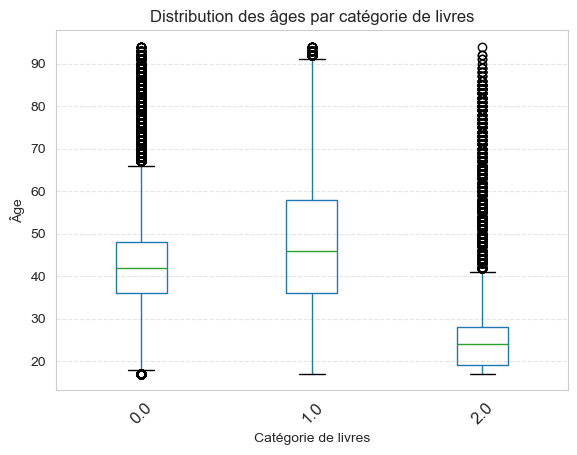

In [155]:
# Étape 1 : Extraire les catégories uniques et les groupes d'âge
categories = Particulier_df['categ'].unique()
age_groups = [Particulier_df[Particulier_df['categ'] == category]['age'] for category in categories]

# Étape 2 : Tester la normalité (test de D'Agostino-Pearson) pour chaque groupe
print("Résultats du test de D'Agostino-Pearson pour la normalité :")
for category, group in zip(categories, age_groups):
    stat, p_value = normaltest(group)
    print(f"Catégorie {category} : p-valeur = {p_value:.4f}")
    if p_value < 0.05:
        print(f" -> La distribution des âges dans la catégorie {category} n'est PAS normale.")
    else:
        print(f" -> La distribution des âges dans la catégorie {category} semble normale.")

# Étape 3 : Tester l'homogénéité des variances (test de Levene)
stat, p_value = levene(*age_groups)
print("\nTest de Levene pour l'homogénéité des variances :")
print(f"Statistique = {stat}, p-valeur = {p_value}")
if p_value < 0.05:
    print(" -> Les variances NE sont PAS homogènes entre les catégories.")
else:
    print(" -> Les variances sont homogènes entre les catégories.")

# Étape 4 : Effectuer le test approprié
if all(normaltest(group)[1] > 0.05 for group in age_groups) and p_value > 0.05:
    # Si la normalité et l'homogénéité sont satisfaites, utiliser l'ANOVA
    stat, p_value = f_oneway(*age_groups)
    print("\nRésultats de l'ANOVA :")
    print(f"F-statistique = {stat}, p-valeur = {p_value}")
    if p_value < 0.05:
        print(" -> Différence significative dans les distributions d'âge entre les catégories de livres (ANOVA).")
    else:
        print(" -> Aucune différence significative dans les distributions d'âge entre les catégories de livres (ANOVA).")
else:
    # Utiliser le test de Kruskal-Wallis comme alternative
    stat, p_value = kruskal(*age_groups)
    print("\nRésultats du test de Kruskal-Wallis :")
    print(f"Statistique = {stat}, p-valeur = {p_value}")
    if p_value < 0.05:
        print(" -> Différence significative dans les distributions d'âge entre les catégories de livres (Kruskal-Wallis).")
    else:
        print(" -> Aucune différence significative dans les distributions d'âge entre les catégories de livres (Kruskal-Wallis).")

# Étape 5 : Visualiser avec un diagramme en boîte
plt.figure(figsize=(10, 6))
Particulier_df.boxplot(column='age', by='categ', grid=False)
plt.title('Distribution des âges par catégorie de livres')
plt.suptitle('')  # Supprimer le titre automatique
plt.xlabel('Catégorie de livres')
plt.ylabel('Âge')
plt.xticks(rotation=45, fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.show()

## Etape 8 - export des dcouments en csv

In [ ]:
 
merged_df.to_csv('merged_df.csv', index=False)

#exporte 
Particulier_df.to_csv('filtered_df.csv', index=False)
#exporte 
pro_df.to_csv('top_4_clients_only.csv', index=False)